# Experiment 1 - q* reliability 
This is a cleaned notebook responsible to analyze the results obtained by running experiment 1. It loads the data, prints important statistics, and creates the plots.

In [1]:
import pickle
import numpy as np
import pandas as pd
import torch
from torch.autograd import Variable
import torch.nn.functional as F
from utils.helper import get_model, get_loaders
from utils.hparams import HParams
from utils.math_ops import log_bernoulli, log_normal, log_mean_exp, safe_repeat

K_EVAL = 5_000  # same as they use it in the paper
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

datasets = {
    "MNIST": {
        "eval_path": "checkpoints/mnist/warmup/ffg/3280_model.pth",
        "results_path": "results/experiment1_final_mnist/experiment1_results.pkl",
        "dataset_name": "mnist",
    },
    "Fashion-MNIST": {
        "eval_path": "checkpoints/fashion/warmup/ffg/3280_fashion_model.pth",
        "results_path": "results/experiment1_fashion/experiment1_results.pkl",
        "dataset_name": "fashion",
    },
}

DEVICE

'cpu'

In [4]:
def evaluate_q(model, datapoint, mean, logvar, k=5000):
    z_size = model.z_size

    mean = torch.tensor(mean, dtype=torch.float32).view(1, z_size)
    logvar = torch.tensor(logvar, dtype=torch.float32).view(1, z_size)
    if DEVICE == "cuda":
        mean, logvar = mean.cuda(), logvar.cuda()

    mean_exp = mean.expand(k, z_size)
    logvar_exp = logvar.expand(k, z_size)
    data_exp = safe_repeat(datapoint, k)
    zeros = torch.zeros(k, z_size).type(model.dtype)

    eps = torch.randn(k, z_size).type(model.dtype)
    z = eps * (logvar_exp * 0.5).exp() + mean_exp

    # i can ujse their implementations of log_bernoulli / lognormal to get the weights
    log_weights = (
        log_bernoulli(model.decode(z), data_exp)
        + log_normal(z, zeros, zeros)
        - log_normal(z, mean_exp, logvar_exp)
    )

    return log_weights.mean().item(), log_mean_exp(log_weights.view(1, k)).item()


def evaluate_encoder(model, datapoint, k=5000):
    z_size = model.z_size
    data_exp = safe_repeat(datapoint, k)
    zeros = torch.zeros(k, z_size).type(model.dtype)

    mean, logvar, _ = model.encode(data_exp)
    eps = torch.randn(k, z_size).type(model.dtype)
    z = eps * (logvar * 0.5).exp() + mean

    log_weights = (
        log_bernoulli(model.decode(z), data_exp)
        + log_normal(z, zeros, zeros)
        - log_normal(z, mean, logvar)
    )

    return log_weights.mean().item(), log_mean_exp(log_weights.view(1, k)).item()

In [2]:
all_data = {}

for dataset_name, config in datasets.items():
    with open(config['results_path'], 'rb') as f:
        exp_results = pickle.load(f)
    
    hparams = HParams(
        z_size=50, act_func=F.elu, has_flow=False, 
        hamiltonian_flow=False, n_flows=0, 
        wide_encoder=False, cuda=(DEVICE=="cuda")
    )
    model = get_model(config['dataset_name'], hparams)
    model.load_state_dict(torch.load(config['eval_path'])["state_dict"])
    model.eval()
    for param in model.parameters():
        param.requires_grad = False
    
    train_loader, _ = get_loaders(
        dataset=config['dataset_name'], 
        evaluate=True, 
        batch_size=1
    )
    dataset_data = torch.cat([batch for batch, _ in train_loader], dim=0)
    all_data[dataset_name] = {
        'model': model,
        'dataset': dataset_data,
        'exp_results': exp_results,
        'datapoint_indices': exp_results['datapoint_indices']
    }
    
    N = len(exp_results['datapoint_indices'])
    R, K = exp_results['iwae_elbo'].shape[1:3] # i unfortunately saved the data with the R,K shape so i need to account for that here :(

In [3]:
all_data

{'MNIST': {'model': VAE(
    (fc1): Linear(in_features=784, out_features=200, bias=True)
    (fc2): Linear(in_features=200, out_features=200, bias=True)
    (fc3): Linear(in_features=200, out_features=100, bias=True)
    (fc4): Linear(in_features=50, out_features=200, bias=True)
    (fc5): Linear(in_features=200, out_features=200, bias=True)
    (fc6): Linear(in_features=200, out_features=784, bias=True)
    (x_info_layer): Linear(in_features=200, out_features=50, bias=True)
  ),
  'dataset': tensor([[0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          ...,
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.],
          [0., 0., 0.,  ..., 0., 0., 0.]]),
  'exp_results': {'vae_elbo': array([[[-114.86917877, -114.67060852, -114.95863342, -114.73355103,
            -114.4847641 ],
           [-115.06812286, -114.88804626, -114.63201141, -115.00086975,
            -114.87322235],
        

In [5]:
results_dict = {}
variance_data = {}  
for dataset_name, data in all_data.items():    
    model = data['model']
    dataset = data['dataset']
    exp_results = data['exp_results']
    datapoint_indices = data['datapoint_indices']
    N = len(datapoint_indices)
    R, K = exp_results['iwae_elbo'].shape[1:3]
    
    # i need to store the single elbos and also the aggregated ones
    results = []
    all_datapoint_elbos = []
    for i in range(N):
        idx = datapoint_indices[i]
        datapoint = Variable(dataset[idx:idx+1].type(model.dtype))
        
        # 1: get all the ELBOs (so that we can select the best one after that)
        datapoint_elbos = []  # all q* elobs for this datapoint
        best_elbo_selection = -np.inf
        best_params = None
        
        for r in range(R):
            for k_idx in range(K):
                elbo, _ = evaluate_q(
                    model, datapoint,
                    exp_results['final_means'][i, r, k_idx],
                    exp_results['final_logvars'][i, r, k_idx],
                    k=5_000#K_EVAL
                )
                datapoint_elbos.append(elbo)
                if elbo > best_elbo_selection:
                    best_elbo_selection = elbo
                    best_params = (r, k_idx)
        
        q_star_baseline_elbo, _ = evaluate_q(
            model, datapoint,
            exp_results['baseline_final_mean'][i],
            exp_results['baseline_final_logvar'][i],
            k=K_EVAL
        )
        all_datapoint_elbos.append(datapoint_elbos)
        
        # 2: reevaluate to avoid selection bias
        r_best, k_best = best_params
        q_star_best_elbo, best_logpx = evaluate_q(
            model, datapoint,
            exp_results['final_means'][i, r_best, k_best],
            exp_results['final_logvars'][i, r_best, k_best],
            k=K_EVAL
        )
        
        # 3: also evaluate the encoder
        q_phi_elbo, _ = evaluate_encoder(model, datapoint, k=K_EVAL)
        
        results.append({
            'datapoint': i,
            'logpx': best_logpx,
            'q_phi_elbo': q_phi_elbo,
            'q_star_baseline_elbo': q_star_baseline_elbo,
            'q_star_best_elbo': q_star_best_elbo,
            'best_run': best_params
        })
        
        if (i + 1) % 10 == 0:
            print(f"  {i+1}/{N} complete")
    
    results_dict[dataset_name] = pd.DataFrame(results)
    variance_data[dataset_name] = all_datapoint_elbos

  10/50 complete
  20/50 complete
  30/50 complete
  40/50 complete
  50/50 complete
  10/50 complete
  20/50 complete
  30/50 complete
  40/50 complete
  50/50 complete


In [6]:
results_dict["MNIST"]

,datapoint,logpx,q_phi_elbo,q_star_baseline_elbo,q_star_best_elbo,best_run
0,0,-112.434967,-118.013046,-114.872528,-114.873512,"(3, 2)"
1,1,-100.997665,-103.441025,-101.942322,-101.961464,"(2, 1)"
2,2,-105.292015,-108.935989,-107.034348,-107.064316,"(1, 4)"
3,3,-49.196484,-50.328224,-50.121292,-50.088093,"(6, 3)"
4,4,-86.423836,-88.618446,-87.495529,-87.530991,"(5, 3)"
5,5,-116.702103,-120.646927,-118.403412,-118.317879,"(3, 3)"
6,6,-48.506287,-49.951836,-49.477917,-49.458878,"(6, 1)"
7,7,-103.004044,-105.351166,-104.052254,-104.050591,"(9, 3)"
8,8,-41.956730,-42.845589,-42.544361,-42.547176,"(9, 3)"
9,9,-89.287430,-91.789917,-90.757004,-90.730652,"(2, 2)"


In [ ]:
print("\n" + "="*70)
print("THREE-GAP DECOMPOSITION")
print("="*70)

gap_analysis = {}

for dataset_name, df in results_dict.items():
    print(f"\n{dataset_name}:")
    print("-" * 50)
    
    logpx = df['logpx']
    q_star_best = df['q_star_best_elbo']
    q_star_baseline = df['q_star_baseline_elbo']
    q_phi = df['q_phi_elbo']
    
    approx_gap = logpx - q_star_best
    optim_gap = q_star_best - q_star_baseline
    amor_gap = q_star_baseline - q_phi
    infer_gap = logpx - q_phi
    
    print("Absolute gaps (mean, nats):")
    print(f"  Approximation:  {approx_gap.mean():.4f}")
    print(f"  Optimization:   {optim_gap.mean():.4f}")
    print(f"  Amortization:   {amor_gap.mean():.4f}")
    print(f"  ────────────────────────")
    print(f"  Inference:      {infer_gap.mean():.4f}")
    print(f"  Sum check:      {(approx_gap + optim_gap + amor_gap).mean():.4f}")
    
    pct_approx = (approx_gap / infer_gap * 100).median()
    pct_optim = (optim_gap / infer_gap * 100).median()
    pct_amor = (amor_gap / infer_gap * 100).median()
    
    print(f"\nRelative contributions (median %):")
    print(f"  Approximation:  {pct_approx:.1f}%")
    print(f"  Optimization:   {pct_optim:.1f}%")
    print(f"  Amortization:   {pct_amor:.1f}%")
    print(f"  ────────────────────────")
    print(f"  Total:          {pct_approx + pct_optim + pct_amor:.1f}%")
    
    gap_analysis[dataset_name] = {
        'approx_gap': approx_gap,
        'optim_gap': optim_gap,
        'amor_gap': amor_gap,
        'infer_gap': infer_gap,
        'pct_approx': pct_approx,
        'pct_optim': pct_optim,
        'pct_amor': pct_amor
    }

print("\n" + "="*70)


THREE-GAP DECOMPOSITION

MNIST:
--------------------------------------------------
Absolute gaps (mean, nats):
  Approximation:  1.3111
  Optimization:   0.0017
  Amortization:   1.3718
  ────────────────────────
  Inference:      2.6846
  Sum check:      2.6846

Relative contributions (median %):
  Approximation:  51.4%
  Optimization:   0.1%
  Amortization:   49.3%
  ────────────────────────
  Total:          100.9%

Fashion-MNIST:
--------------------------------------------------
Absolute gaps (mean, nats):
  Approximation:  2.9885
  Optimization:   0.0152
  Amortization:   4.1858
  ────────────────────────
  Inference:      7.1894
  Sum check:      7.1894

Relative contributions (median %):
  Approximation:  42.6%
  Optimization:   0.1%
  Amortization:   56.5%
  ────────────────────────
  Total:          99.3%



In [6]:
0.0017 / 2.6846

0.0006332414512404082

In [7]:
0.0152 / 7.1894

0.002114223718251871

### Here are the plots that i use in the paper

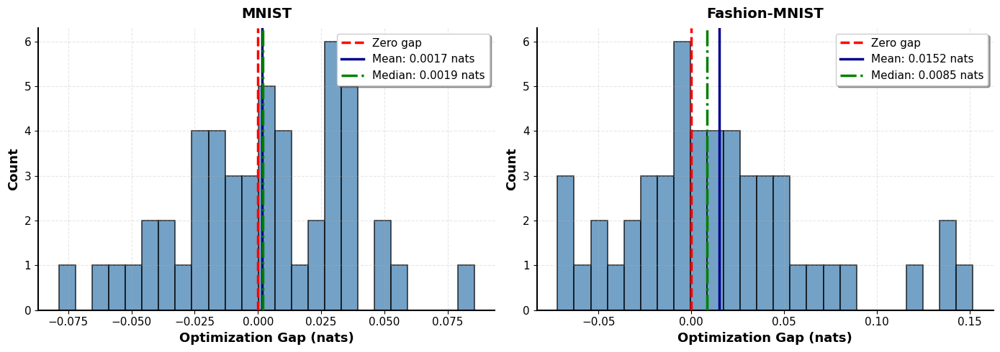

Figure saved as 'figures/experiment1_optimization_gap_distribution_horizontal.png'


In [ ]:
# i decided not to use this one in the paper 

import matplotlib.pyplot as plt

fig, axes = plt.subplots(1, 2, figsize=(14, 5))

datasets_list = ["MNIST", "Fashion-MNIST"]
for idx, dataset_name in enumerate(datasets_list):
    g = gap_analysis[dataset_name]
    optim_gap = g["optim_gap"]

    ax = axes[idx]

    n, bins, patches = ax.hist(
        optim_gap,
        bins=25,
        edgecolor="black",
        alpha=0.75,
        color="steelblue",
        linewidth=1.2,
    )

    ax.axvline(
        0, color="red", linestyle="--", linewidth=2.5, label="Zero gap", zorder=5
    )
    ax.axvline(
        optim_gap.mean(),
        color="darkblue",
        linestyle="-",
        linewidth=2.5,
        label=f"Mean: {optim_gap.mean():.4f} nats",
        zorder=5,
    )
    ax.axvline(
        optim_gap.median(),
        color="green",
        linestyle="-.",
        linewidth=2.5,
        label=f"Median: {optim_gap.median():.4f} nats",
        zorder=5,
    )

    ax.set_xlabel("Optimization Gap (nats)", fontsize=13, fontweight="bold")
    ax.set_ylabel("Count", fontsize=13, fontweight="bold")
    ax.set_title(f"{dataset_name}", fontsize=14, fontweight="bold", pad=10)
    ax.legend(fontsize=11, frameon=True, shadow=True, loc="upper right")
    ax.grid(alpha=0.3, linestyle="--", linewidth=0.8)
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)
    ax.spines["left"].set_linewidth(1.5)
    ax.spines["bottom"].set_linewidth(1.5)
    ax.tick_params(labelsize=11)

plt.tight_layout()
plt.savefig(
    "figures/experiment1_optimization_gap_distribution_horizontal.png",
    dpi=300,
    bbox_inches="tight",
)
plt.show()

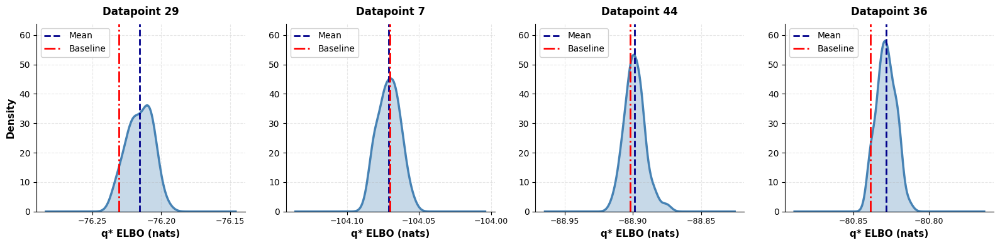

Figure saved as 'figures/experiment1_qstar_variance_4examples.png'


In [ ]:
from scipy.stats import gaussian_kde
import numpy as np

fig, axes = plt.subplots(1, 4, figsize=(16, 4))

all_elbos = variance_data["MNIST"]
N = len(all_elbos)
selected_indices = np.random.choice(N, size=4, replace=False)

# get a global y axis so its comparable (this was feedback by Simon)
all_densities = []
for datapoint_idx in selected_indices:
    elbos = np.array(all_elbos[datapoint_idx])
    kde = gaussian_kde(elbos, bw_method="scott")
    x_min, x_max = elbos.min() - 0.05, elbos.max() + 0.05
    x_range = np.linspace(x_min, x_max, 200)
    density = kde(x_range)
    all_densities.append(density.max())

y_max = max(all_densities) * 1.1
for plot_idx, datapoint_idx in enumerate(selected_indices):
    ax = axes[plot_idx]
    elbos = np.array(all_elbos[datapoint_idx])

    baseline_elbo = elbos[-1]
    kde = gaussian_kde(elbos, bw_method="scott")
    x_min, x_max = elbos.min() - 0.05, elbos.max() + 0.05
    x_range = np.linspace(x_min, x_max, 200)
    density = kde(x_range)

    ax.plot(x_range, density, linewidth=2.5, color="steelblue")
    ax.fill_between(x_range, density, alpha=0.3, color="steelblue")
    ax.axvline(
        elbos.mean(), color="darkblue", linestyle="--", linewidth=2, label="Mean"
    )
    ax.axvline(
        baseline_elbo, color="red", linestyle="-.", linewidth=2, label="Baseline"
    )
    ax.set_xlabel("q* ELBO (nats)", fontsize=11, fontweight="bold")
    if plot_idx == 0:
        ax.set_ylabel("Density", fontsize=11, fontweight="bold")
    ax.set_title(f"Datapoint {datapoint_idx}", fontsize=12, fontweight="bold", pad=10)
    ax.legend(fontsize=10, framealpha=0.9, loc="upper left")
    ax.grid(alpha=0.3, linestyle="--")
    ax.set_ylim(0, y_max)
    ax.tick_params(axis="x", labelsize=9)
    ax.locator_params(axis="x", nbins=5)
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)

plt.tight_layout()
plt.savefig(
    "figures/experiment1_qstar_variance_4examples.png", dpi=300, bbox_inches="tight"
)
plt.show()